##  Load Modules

In [2]:
import copy
import glob
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pytorch_lightning as pl
import seaborn as sns
import sys
import torch
import torchvision

from lightly.loss import NegativeCosineSimilarity, NTXentLoss
from lightly.models.modules import BYOLPredictionHead, BYOLProjectionHead
from lightly.models.utils import deactivate_requires_grad, update_momentum
from lightly.utils.scheduler import cosine_schedule
from numpy.linalg import norm
from sklearn.metrics import davies_bouldin_score
from sklearn.model_selection import ParameterGrid
from torch import nn
from torch.utils.data import Dataset
from tqdm.autonotebook import tqdm

device = "cuda" if torch.cuda.is_available() else "cpu"
if device == "cuda":
    from cuml import UMAP
    from cuml.cluster import hdbscan
    from cuml.metrics.cluster.silhouette_score import cython_silhouette_score as silhouette_score
else:
    import hdbscan
    import umap as UMAP
    from sklearn.metrics import silhouette_score

torch.set_float32_matmul_precision("high")

sys.path.append('./../hits_sdo_scripts')
from hits_sdo_scripts.augmentation import Augmentations
from hits_sdo_scripts.augmentation_list import AugmentationList
from hits_sdo_scripts.image_utils import read_image

ModuleNotFoundError: No module named 'hits_sdo_scripts'

## Define run parameters and initalize Wandb

In [3]:
data_path = '/home/amunozj/data/search/AIA211_193_171_256x256'

In [4]:
seed = 42
pl.seed_everything(seed, workers=True)

epochs = 16
data_stride = 1
batch_size = 64
augmentation = 'double'
loss = 'contrast'   # 'contrast' or 'cos'
learning_rate = 0.1
cosine_scheduler_start = .1
cosine_scheduler_end = 1.0
projection_size = 128
prediction_size = 128

name = f"Test"

Global seed set to 42
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: amunozj (search-byol). Use `wandb login --relogin` to force relogin


In [ ]:
class SDOTilesDataset(Dataset):
    '''
        Dataset to load jpg patches produced by the search packager:
        https://github.com/hits-sdo/hits-sdo-packager
        
        and downloaded by the downloader:
        https://github.com/hits-sdo/hits-sdo-downloader
        
        It performs single or double augmentation on each patch using
        the augmentation modules of the packager
    '''
    def __init__(self, data_path: str, augmentation: str='single',
                 data_stride:int = 1, datatype=np.float32):
        '''
            Initializes image files in the dataset
            
            Args:
                data_path (str): path to the folder containing the images
                augmentation (str): whether to just return the original patches ('none')
                                    perform single augmentation ('single') 
                                    or perform double augmentation ('double').
                                    No augmentation returns a single image,
                                    single or double augmentation returns two.
                data_stride (int): stride to use when loading the images to work 
                                    with a reduced version of the data
                datatype (numpy.dtype): datatype to use for the images
        '''
        self.data_path = data_path
        self.image_files = glob.glob(data_path + "/**/*.jpg", recursive=True)
        if data_stride>1:
            self.image_files = self.image_files[::data_stride]
        self.augmentation_list = AugmentationList(instrument="euv")
        self.augmentation_list.keys.remove('brighten')
        self.datatype=datatype
        self.augmentation = augmentation
        if self.augmentation is None:
            self.augmentation = 'none'

    def __len__(self):
        '''
            Calculates the number of images in the dataset
                
            Returns:
                int: number of images in the dataset
        '''
        return len(self.image_files)

    def __getitem__(self, idx):
        '''
            Retrieves an image from the dataset and creates a copy of it,
            applying a series of random augmentations to the copy.

            Args:
                idx (int): index of the image to retrieve
                
            Returns:
                tuple: (image, image2) where image2 is an augmented modification
                of the input and image can be the original image, or another augmented
                modification, in which case image2 is double augmented
        '''
        image = read_image(image_loc = self.image_files[idx],
                           image_format="jpg")

        if self.augmentation.lower() != 'none':
            # image2 = image.copy()

            aug = Augmentations(image, self.augmentation_list.randomize())
            image2, _ = aug.perform_augmentations(fill_void='Nearest')

            if self.augmentation.lower() == 'double':
                aug = Augmentations(image, self.augmentation_list.randomize())
                image, _ = aug.perform_augmentations(fill_void='Nearest')

            image = np.moveaxis(image, [0, 1, 2], [1, 2, 0]).astype(self.datatype)           
            image2 = np.moveaxis(image2, [0, 1, 2], [1, 2, 0]).astype(self.datatype)           

            return image, image2, self.image_files[idx]

        else:

            image = np.moveaxis(image, [0, 1, 2], [1, 2, 0]).astype(self.datatype)           
            return image, self.image_files[idx]

## Define BYOL Model

In [5]:
class BYOL(pl.LightningModule):
    def __init__(self, lr=0.1, projection_size=256, prediction_size=256, cosine_scheduler_start=0.1, cosine_scheduler_end=1.0, epochs=10, loss='cos'):
        super().__init__()

        resnet = torchvision.models.resnet18() # Play w/ resnet.
        self.backbone = nn.Sequential(*list(resnet.children())[:-1])
        self.projection_head = BYOLProjectionHead(512, 1024, projection_size)
        self.prediction_head = BYOLPredictionHead(projection_size, 1024, prediction_size)

        self.backbone_momentum = copy.deepcopy(self.backbone)
        self.projection_head_momentum = copy.deepcopy(self.projection_head)

        deactivate_requires_grad(self.backbone_momentum)
        deactivate_requires_grad(self.projection_head_momentum)


        self.loss = loss
        self.loss_cos = NegativeCosineSimilarity()
        self.loss_contrast = NTXentLoss()

        self.cosine_scheduler_start = cosine_scheduler_start
        self.cosine_scheduler_end = cosine_scheduler_end
        self.epochs = epochs
        self.lr = lr

    def forward(self, x):
        y = self.backbone(x).flatten(start_dim=1)
        z = self.projection_head(y)
        p = self.prediction_head(z)
        return p

    def forward_momentum(self, x):
        y = self.backbone_momentum(x).flatten(start_dim=1)
        z = self.projection_head_momentum(y)
        z = z.detach()
        return z

    def training_step(self, batch, batch_idx):

        momentum = cosine_schedule(self.current_epoch, self.epochs, self.cosine_scheduler_start, self.cosine_scheduler_end)
        update_momentum(self.backbone, self.backbone_momentum, m=momentum)
        update_momentum(self.projection_head, self.projection_head_momentum, m=momentum)
        (x0, x1, _) = batch
        p0 = self.forward(x0)
        z0 = self.forward_momentum(x0)
        p1 = self.forward(x1)
        z1 = self.forward_momentum(x1)

        loss_cos = 0.5 * (self.loss_cos(p0, z1) + self.loss_cos(p1, z0))
        loss_contrast = 0.5 * (self.loss_contrast(p0, z1) + self.loss_contrast(p1, z0))

        if self.loss == 'cos':
            loss = loss_cos
        else:
            loss = loss_contrast

        self.log('loss cos', loss_cos)
        self.log('loss contrast', loss_contrast)
        self.log('loss', loss)
        return loss

    def configure_optimizers(self):
        return torch.optim.SGD(self.parameters(), lr=self.lr) # Play w/ optimizers.


## Initialize Module

In [6]:
model = BYOL(lr=learning_rate, projection_size=projection_size, prediction_size=prediction_size, cosine_scheduler_start=cosine_scheduler_start, cosine_scheduler_end=cosine_scheduler_end, loss=loss)

## Initialize Dataloader

In [7]:
dataset = SDOTilesDataset(data_path=data_path, augmentation=augmentation, data_stride=data_stride)

dataloader = torch.utils.data.DataLoader(
    dataset,
    batch_size=batch_size,
    shuffle=True,
    drop_last=False,
    num_workers=16,
)

ValueError: num_samples should be a positive integer value, but got num_samples=0

## Run Training Loop, Inference, and log in wandb

In [8]:
trainer = pl.Trainer(max_epochs=epochs,
                     accelerator="gpu", devices=1, strategy="auto",
                     logger=wandb_logger, log_every_n_steps=4, deterministic=True)

wandb_logger.watch(model)
trainer.fit(model=model, train_dataloaders=dataloader)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
wandb: logging graph, to disable use `wandb.watch(log_graph=False)`
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]

  | Name                     | Type                     | Params
----------------------------------------------------------------------
0 | backbone                 | Sequential               | 11.2 M
1 | projection_head          | BYOLProjectionHead       | 657 K 
2 | prediction_head          | BYOLPredictionHead       | 264 K 
3 | backbone_momentum        | Sequential               | 11.2 M
4 | projection_head_momentum | BYOLProjectionHead       | 657 K 
5 | loss_cos                 | NegativeCosineSimilarity | 0     
6 | loss_contrast            | NTXentLoss               | 0     
----------------------------------------------------------------------
12.1 M    Trainable params
11.8 M    Non-trainable params
23.9 M    T

Training: 0it [00:00, ?it/s]

/home/amunozj/.conda/envs/search-ssl/lib/python3.10/site-packages/lightly/utils/scheduler.py:32: RuntimeWarning: Current step number 11 exceeds max_steps 10.
  warnings.warn(
/home/amunozj/.conda/envs/search-ssl/lib/python3.10/site-packages/lightly/utils/scheduler.py:32: RuntimeWarning: Current step number 12 exceeds max_steps 10.
  warnings.warn(
/home/amunozj/.conda/envs/search-ssl/lib/python3.10/site-packages/lightly/utils/scheduler.py:32: RuntimeWarning: Current step number 13 exceeds max_steps 10.
  warnings.warn(
/home/amunozj/.conda/envs/search-ssl/lib/python3.10/site-packages/lightly/utils/scheduler.py:32: RuntimeWarning: Current step number 14 exceeds max_steps 10.
  warnings.warn(
/home/amunozj/.conda/envs/search-ssl/lib/python3.10/site-packages/lightly/utils/scheduler.py:32: RuntimeWarning: Current step number 15 exceeds max_steps 10.
  warnings.warn(
`Trainer.fit` stopped: `max_epochs=16` reached.


### Save model to wandb

In [9]:
torch.save(model.state_dict(), f'{name}_.pt')
wandb.save(f'{name}_.pt')

['./wandb/run-20230720_200053-llves7dt/files/AMJ-ds1_bs64_lr0.1_doubleaug_ss0.1_se1.0_pjs128_pds128_contrast_.pt']

## Run inference

In [10]:
dataset_inference = SDOTilesDataset(data_path=data_path, augmentation='none', data_stride=1)

dataloader_inference = torch.utils.data.DataLoader(
    dataset_inference,
    batch_size=1000,
    shuffle=True,
    drop_last=False,
    num_workers=8,
)

batches_bar = tqdm(dataloader_inference, dynamic_ncols=True, leave=True, desc=f'Running inference on batches')


model.to(device)
model.eval()
inference_list = []
filename_list = []

for (x0, image_file) in batches_bar:
    embeddings_inference = model.forward_momentum(x0.to(device)).cpu().numpy()
    inference_list.append(embeddings_inference)
    filename_list.append(image_file)

embeddings_inference = np.concatenate(inference_list, axis=0)
returned_images = np.concatenate(filename_list)

Running inference on batches:   0%|          | 0/74 [00:00<?, ?it/s]

# Cluster evaluation.

### Relative validity calculation taken from HDBSCAN cpu

In [11]:
def relative_validity(labels_, minimum_spanning_tree_):

    labels = labels_
    sizes = np.bincount(labels + 1)
    noise_size = sizes[0]
    cluster_size = sizes[1:]
    total = noise_size + np.sum(cluster_size)
    num_clusters = len(cluster_size)
    DSC = np.zeros(num_clusters)
    min_outlier_sep = np.inf  # only required if num_clusters = 1
    correction_const = 2  # only required if num_clusters = 1

    # Unltimately, for each Ci, we only require the
    # minimum of DSPC(Ci, Cj) over all Cj != Ci.
    # So let's call this value DSPC_wrt(Ci), i.e.
    # density separation 'with respect to' Ci.
    DSPC_wrt = np.ones(num_clusters) * np.inf
    max_distance = 0

    mst_df = minimum_spanning_tree_.to_pandas()

    for edge in mst_df.iterrows():
        label1 = labels[int(edge[1]["from"])]
        label2 = labels[int(edge[1]["to"])]
        length = edge[1]["distance"]

        max_distance = max(max_distance, length)

        if label1 == -1 and label2 == -1:
            continue
        elif label1 == -1 or label2 == -1:
            # If exactly one of the points is noise
            min_outlier_sep = min(min_outlier_sep, length)
            continue

        if label1 == label2:
            # Set the density sparseness of the cluster
            # to the sparsest value seen so far.
            DSC[label1] = max(length, DSC[label1])
        else:
            # Check whether density separations with
            # respect to each of these clusters can
            # be reduced.
            DSPC_wrt[label1] = min(length, DSPC_wrt[label1])
            DSPC_wrt[label2] = min(length, DSPC_wrt[label2])

    # In case min_outlier_sep is still np.inf, we assign a new value to it.
    # This only makes sense if num_clusters = 1 since it has turned out
    # that the MR-MST has no edges between a noise point and a core point.
    min_outlier_sep = max_distance if min_outlier_sep == np.inf else min_outlier_sep

    # DSPC_wrt[Ci] might be infinite if the connected component for Ci is
    # an "island" in the MR-MST. Whereas for other clusters Cj and Ck, the
    # MR-MST might contain an edge with one point in Cj and ther other one
    # in Ck. Here, we replace the infinite density separation of Ci by
    # another large enough value.
    #
    # TODO: Think of a better yet efficient way to handle this.
    correction = correction_const * (
        max_distance if num_clusters > 1 else min_outlier_sep
    )
    DSPC_wrt[np.where(DSPC_wrt == np.inf)] = correction

    V_index = [
        (DSPC_wrt[i] - DSC[i]) / max(DSPC_wrt[i], DSC[i])
        for i in range(num_clusters)
    ]
    score = np.sum(
        [(cluster_size[i] * V_index[i]) / total for i in range(num_clusters)]
    )
    _relative_validity = score
    return _relative_validity

In [12]:
# specify parameters and distributions to sample from
param_dist = {'min_samples': [2],
              'min_cluster_size':[2, 4, 8, 16, 32, 64, 128, 256],
              'cluster_selection_method' : ['leaf'],
              'cluster_selection_epsilon' : [0.0, 0.1, 0.2, 0.3],
              'metric' : ['euclidean'],
              'gen_min_span_tree' : [True]
             }

wandb.config.update(param_dist)

### Normalizing embeddings so that Euclidean distance corresponds to Cosine distance

In [13]:
normalized_embeddings = embeddings_inference/norm(embeddings_inference, axis=1, ord=2)[:,None]

**IMPORTANT**: If the program crashes with `CUDADriverError: CUDA_ERROR_INVALID_VALUE: invalid argument` it means you are running out of VRAM during the silhouette calculation and need to increase the stride in the calculation

In [14]:
#Increase this number if you run out of memory (see above)
silhouette_stride = 10

parameter_list =  list(ParameterGrid(param_dist))
relative_validity_list = []
DBIndex_list = []
silhouette_list = []

best_validity=-1
best_dbindex=-1
best_silhouette=-1
parameters_bar = tqdm(ParameterGrid(param_dist), desc=f'Best relative validity {best_validity:>02}, Best DBindex {best_dbindex:>02}, Best silhouette {best_silhouette:>02}')
for parameters in parameters_bar:
  clusterer = hdbscan.HDBSCAN(**parameters)
  clusterer.fit(normalized_embeddings)
  relative_validity_list.append(relative_validity(clusterer.labels_, clusterer.minimum_spanning_tree_))

  ss = silhouette_score(normalized_embeddings[0::silhouette_stride,:], clusterer.labels_[0::silhouette_stride], metric='euclidean')
  silhouette_list.append(ss)

  dbs = davies_bouldin_score(normalized_embeddings, clusterer.labels_)
  DBIndex_list.append(dbs)

  best_validity = np.max(np.array(relative_validity_list))
  best_dbindex = np.min(np.array(DBIndex_list))
  best_silhouette= np.max(np.array(silhouette_list))

  parameters_bar.set_description(f'Best relative validity {best_validity:>02}, Best DBindex {best_dbindex:>02}, Best silhouette {best_silhouette:>02}')
  parameters_bar.refresh()

Best relative validity -1, Best DBindex -1, Best silhouette -1:   0%|          | 0/32 [00:00<?, ?it/s]

## Visualize best parameters

In [15]:
n_neighbors=5
min_dist=0.0
n_components=2
metric='cosine'
spread = 0.5
repulsion_strength = 2

def draw_umap(data, colors, n_neighbors=15, min_dist=0.1, spread=1, n_components=2, repulsion_strength=1.0, metric='euclidean', title='', alpha=0.1):
    fit = UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric,
        spread=spread,
        repulsion_strength=repulsion_strength,
        verbose=True
    )
    u = fit.fit_transform(data);
    fig = plt.figure(figsize=(16,9), dpi=150)
    if n_components == 1:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], range(len(u)), c=colors, s=1, alpha=alpha)
    if n_components == 2:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], u[:,1], c=colors, s=1, alpha=alpha)
    if n_components == 3:
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(u[:,0], u[:,1], u[:,2], c=colors, s=1, alpha=alpha)
    plt.title(title, fontsize=18)

    return fig

[D] [20:41:12.295309] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:108 n_neighbors=5
[D] [20:41:12.297444] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:130 Calling knn graph run
[D] [20:41:12.529086] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:136 Done. Calling fuzzy simplicial set
[D] [20:41:12.530570] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:317 Smooth kNN Distances
[D] [20:41:12.530851] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:319 sigmas = [ 0.00331855, 0.000446767, 0.000840798, 0.0115817, 0.0137303, 0.00383365, 0.0239639, 0.00279975, 0.024725, 0.0343819, 0.00507021, 0.0165772, 0.00805378, 0.00308302, 0.0169818, 0.00175649, 0.00857997, 0.0300241, 0.0158405, 0.00949275, 0.000951454, 0.00122136, 2.53818e-05, 0.00624096, 8.31969e-05 ]

[D] [20:41:12.530977] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:321 rhos = [ 0.00290529, 0.00494373, 0.0041331, 0.0169036, 0.0162698, 0.00876849, 0.0818244, 0.00313527

{'cluster_selection_epsilon': 0.0,
 'cluster_selection_method': 'leaf',
 'gen_min_span_tree': True,
 'metric': 'euclidean',
 'min_cluster_size': 128,
 'min_samples': 2}

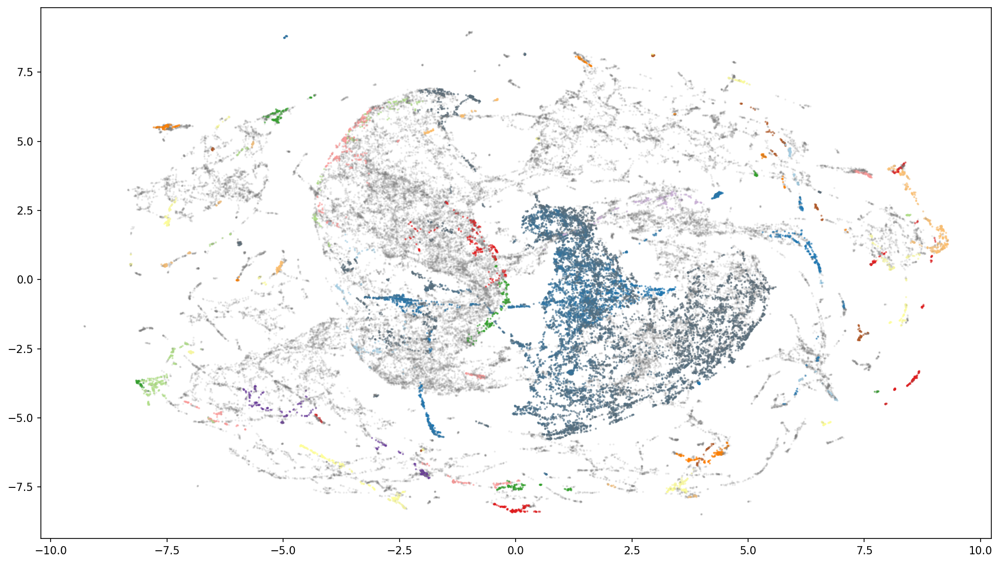

In [16]:
best_index = (np.array(relative_validity_list) == np.max(np.array(relative_validity_list))).nonzero()[0][0]
best_validity = np.max(np.array(relative_validity_list))

clusterer = hdbscan.HDBSCAN(**parameter_list[best_index])
clusterer.fit(normalized_embeddings)

# Plotting best results
sns.color_palette('Paired', clusterer.labels_.max()+1)

color_palette = sns.color_palette('Paired', clusterer.labels_.max()+1)
cluster_colors = [color_palette[x] if x >= 0 else (0.5, 0.5, 0.5) for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in zip(cluster_colors, clusterer.probabilities_)]
cluster_alphas = np.ones_like(clusterer.labels_)*0.5
cluster_alphas[clusterer.labels_==-1] = 0.1

fig = draw_umap(data=normalized_embeddings, colors=cluster_member_colors, n_neighbors=n_neighbors, min_dist=min_dist, repulsion_strength=repulsion_strength, n_components=n_components, spread=spread, metric=metric, title='', alpha=cluster_alphas)

wandb.log({"UMAP 2d Optimal validity": wandb.Image(fig)})

log_df = pd.DataFrame(parameter_list[best_index],index=[0])
best_parameters_table = wandb.Table(dataframe=log_df)
wandb.log({"Best validity parameters": best_parameters_table})

parameter_list[best_index]

[D] [20:41:19.600486] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:108 n_neighbors=5
[D] [20:41:19.602044] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:130 Calling knn graph run
[D] [20:41:19.833414] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:136 Done. Calling fuzzy simplicial set
[D] [20:41:19.834961] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:317 Smooth kNN Distances
[D] [20:41:19.835136] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:319 sigmas = [ 0.00331855, 0.000446767, 0.000840798, 0.0115817, 0.0137303, 0.00383365, 0.0239639, 0.00279975, 0.024725, 0.0343819, 0.00507021, 0.0165772, 0.00805378, 0.00308302, 0.0169818, 0.00175649, 0.00857997, 0.0300241, 0.0158405, 0.00949275, 0.000951454, 0.00122136, 2.53818e-05, 0.00624096, 8.31969e-05 ]

[D] [20:41:19.835267] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:321 rhos = [ 0.00290529, 0.00494373, 0.0041331, 0.0169036, 0.0162698, 0.00876849, 0.0818244, 0.00313527

{'cluster_selection_epsilon': 0.0,
 'cluster_selection_method': 'leaf',
 'gen_min_span_tree': True,
 'metric': 'euclidean',
 'min_cluster_size': 2,
 'min_samples': 2}

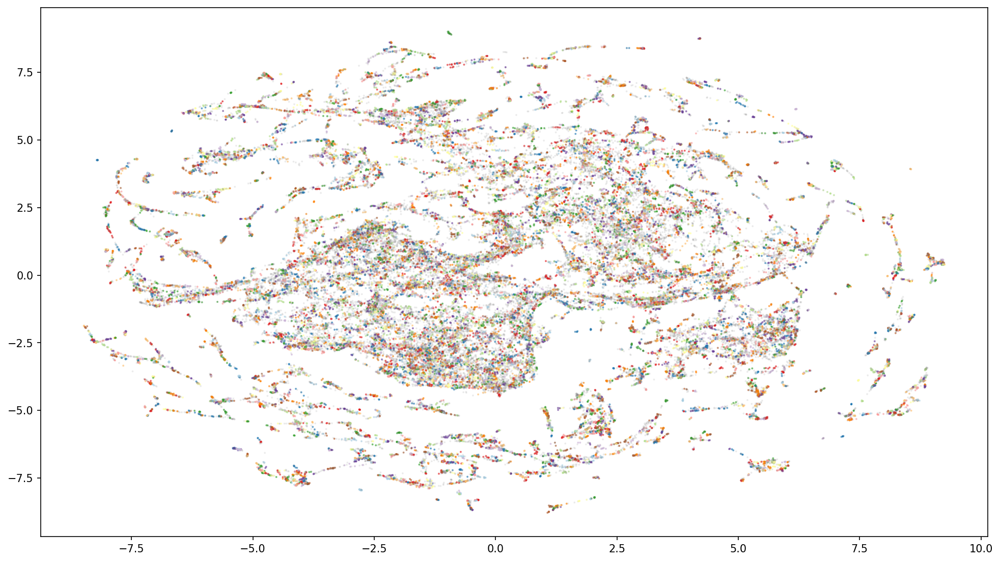

In [17]:
best_index = (np.array(DBIndex_list) == np.min(np.array(DBIndex_list))).nonzero()[0][0]
best_dbindex = np.min(np.array(DBIndex_list))

clusterer = hdbscan.HDBSCAN(**parameter_list[best_index])
clusterer.fit(normalized_embeddings)

# Plotting best results
sns.color_palette('Paired', clusterer.labels_.max()+1)

color_palette = sns.color_palette('Paired', clusterer.labels_.max()+1)
cluster_colors = [color_palette[x] if x >= 0 else (0.5, 0.5, 0.5) for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in zip(cluster_colors, clusterer.probabilities_)]
cluster_alphas = np.ones_like(clusterer.labels_)*0.5
cluster_alphas[clusterer.labels_==-1] = 0.1

fig = draw_umap(data=normalized_embeddings, colors=cluster_member_colors, n_neighbors=n_neighbors, min_dist=min_dist, repulsion_strength=repulsion_strength, n_components=n_components, spread=spread, metric=metric, title='', alpha=cluster_alphas)

wandb.log({"UMAP 2d Optimal DBIndex": wandb.Image(fig)})

log_df = pd.DataFrame(parameter_list[best_index],index=[0])
best_parameters_table = wandb.Table(dataframe=log_df)
wandb.log({"Best DBIndex parameters": best_parameters_table})

parameter_list[best_index]

[D] [20:41:26.412816] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:108 n_neighbors=5
[D] [20:41:26.414055] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:130 Calling knn graph run
[D] [20:41:26.644636] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:136 Done. Calling fuzzy simplicial set
[D] [20:41:26.645784] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:317 Smooth kNN Distances
[D] [20:41:26.646031] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:319 sigmas = [ 0.00331855, 0.000446767, 0.000840798, 0.0115817, 0.0137303, 0.00383365, 0.0239639, 0.00279975, 0.024725, 0.0343819, 0.00507021, 0.0165772, 0.00805378, 0.00308302, 0.0169818, 0.00175649, 0.00857997, 0.0300241, 0.0158405, 0.00949275, 0.000951454, 0.00122136, 2.53818e-05, 0.00624096, 8.31969e-05 ]

[D] [20:41:26.646160] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:321 rhos = [ 0.00290529, 0.00494373, 0.0041331, 0.0169036, 0.0162698, 0.00876849, 0.0818244, 0.00313527

{'cluster_selection_epsilon': 0.2,
 'cluster_selection_method': 'leaf',
 'gen_min_span_tree': True,
 'metric': 'euclidean',
 'min_cluster_size': 128,
 'min_samples': 2}

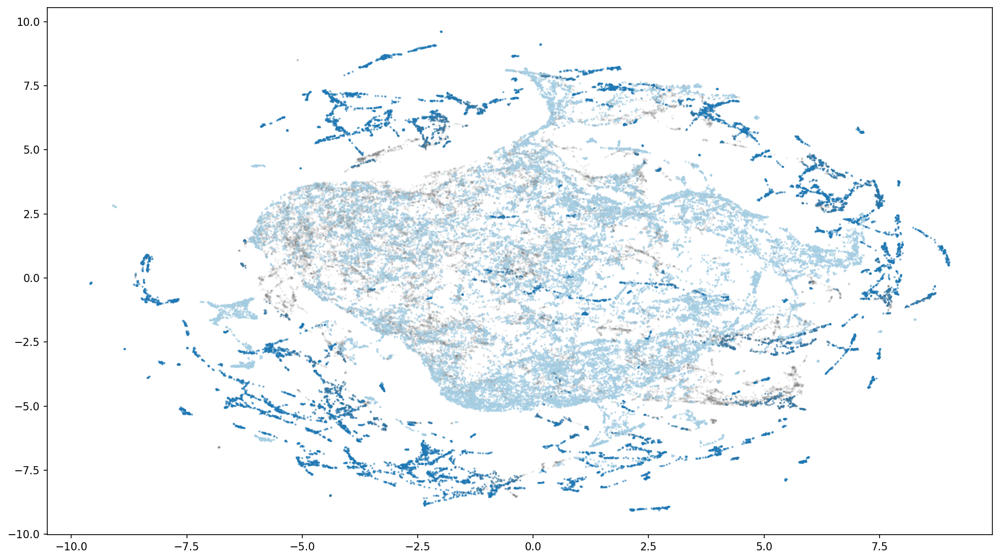

In [18]:
best_index = (np.array(silhouette_list) == np.max(np.array(silhouette_list))).nonzero()[0][0]
best_silhouette = np.max(np.array(silhouette_list))

clusterer = hdbscan.HDBSCAN(**parameter_list[best_index])
clusterer.fit(normalized_embeddings)

# Plotting best results
sns.color_palette('Paired', clusterer.labels_.max()+1)

color_palette = sns.color_palette('Paired', clusterer.labels_.max()+1)
cluster_colors = [color_palette[x] if x >= 0 else (0.5, 0.5, 0.5) for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in zip(cluster_colors, clusterer.probabilities_)]
cluster_alphas = np.ones_like(clusterer.labels_)*0.5
cluster_alphas[clusterer.labels_==-1] = 0.1


fig = draw_umap(data=normalized_embeddings, colors=cluster_member_colors, n_neighbors=n_neighbors, min_dist=min_dist, repulsion_strength=repulsion_strength, n_components=n_components, spread=spread, metric=metric, title='', alpha=cluster_alphas)

wandb.log({"UMAP 2d Optimal silhouette": wandb.Image(fig)})

log_df = pd.DataFrame(parameter_list[best_index],index=[0])
best_parameters_table = wandb.Table(dataframe=log_df)
wandb.log({"Best silhouette parameters": best_parameters_table})

parameter_list[best_index]


In [19]:
wandb.log({'Best Validity:': best_validity,
           'Best Silhouette': best_silhouette,
           'Best DBIndex': best_dbindex})

print('Silhouette Score (best is 1):', best_silhouette)
print('Davies-Bouldin Score (best is 0):', best_dbindex)
print('HDBSCAN Relative Validity (higher is better):', best_validity)
wandb.finish()

Silhouette Score (best is 1): 0.12257230281829834
Davies-Bouldin Score (best is 0): 1.0996185381554526
HDBSCAN Relative Validity (higher is better): 0.1741713258706166


Best DBIndex,▁
Best Silhouette,▁
Best Validity:,▁
epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████
loss,█▅▅▄▃▃▃▃▂▂▃▂▂▃▃▁▁▂▃▂▂▂▁▃▂▁▁▁▁▂▁▂▂▂▃▂▃▃▃▃
loss contrast,█▅▅▄▃▃▃▃▂▂▃▂▂▃▃▁▁▂▃▂▂▂▁▃▂▁▁▁▁▂▁▂▂▂▃▂▃▃▃▃
loss cos,█▇▅▅▄▃▃▃▃▃▄▃▄▃▃▃▃▄▃▃▂▂▃▃▂▂▁▂▂▂▂▂▂▂▂▁▃▃▄▂
trainer/global_step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
Best DBIndex,1.09962
Best Silhouette,0.12257
Best Validity:,0.17417


In [20]:
# fig = draw_umap(data=embeddings_inference, colors=cluster_member_colors, n_neighbors=30, min_dist=0.1, title='n_neighbors = {}'.format(15), n_components=3, alpha=cluster_alphas)

# wandb.log({"UMAP 3d Optimal HDBSCAN": wandb.Image(fig)})

# wandb.finish()

# Cluster plotting and visualization

Init cluster plotting function.

In [21]:
def cluster_plot(cluster_rows:int, cluster_col:int, images_list:np.array, dpi:int):
  fig = plt.figure(figsize=[cluster_col, cluster_rows], layout='constrained', dpi=dpi)
  spec = gridspec.GridSpec(ncols=cluster_col, nrows=cluster_rows, figure=fig, wspace=0, hspace=0)

  # Shuffle list and use first 16 filepaths to plot images
  np.random.shuffle(images_list)

  # For loop to go through and use Team Yellow's load image module
  n = 0
  for j in range(cluster_rows):
    for i in range(cluster_col):
      if images_list.shape[0] > n:
        im = Image.open(images_list[n])
        image = np.array(im).astype(float) / 255
        
        # Scatter plot
        ax1 = fig.add_subplot(spec[j, i])
        ax1.imshow(image)
        ax1.set_xticks([])
        ax1.set_yticks([])
      else:
        break
      n += 1

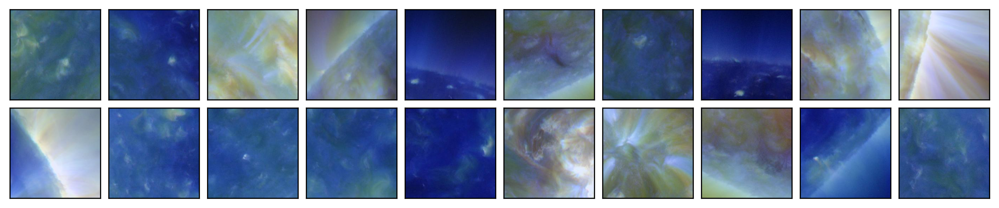

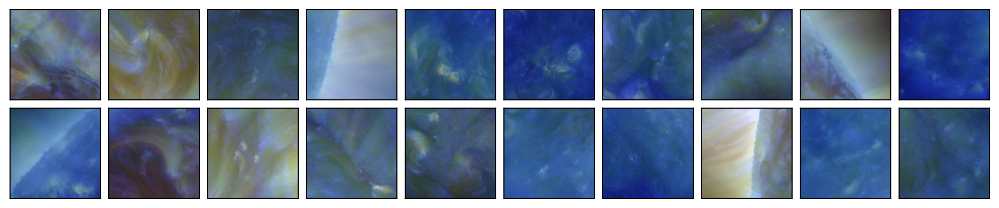

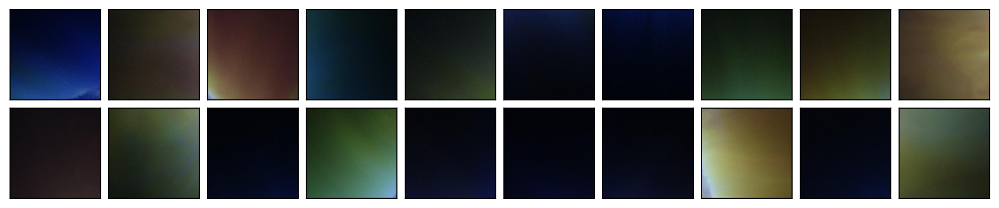

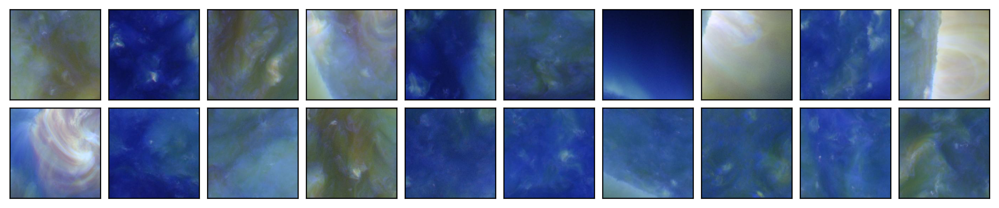

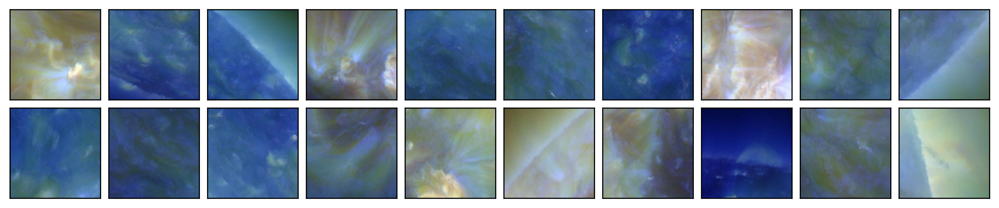

...

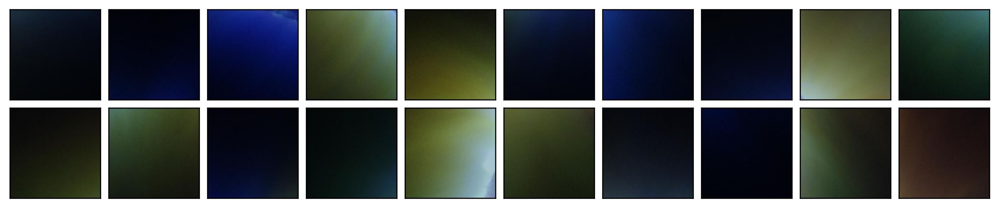

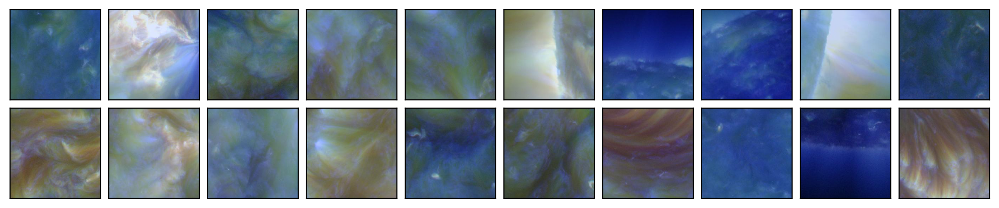

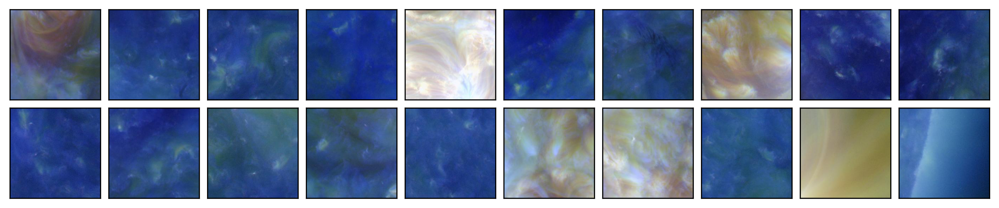

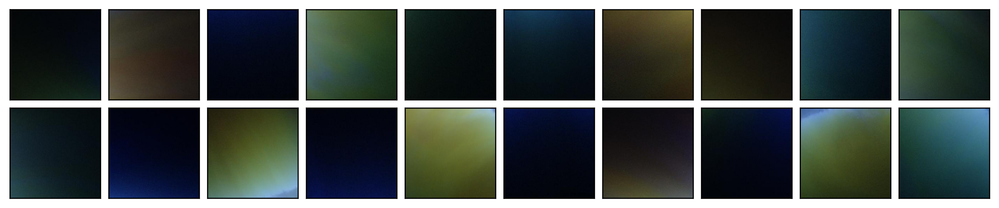

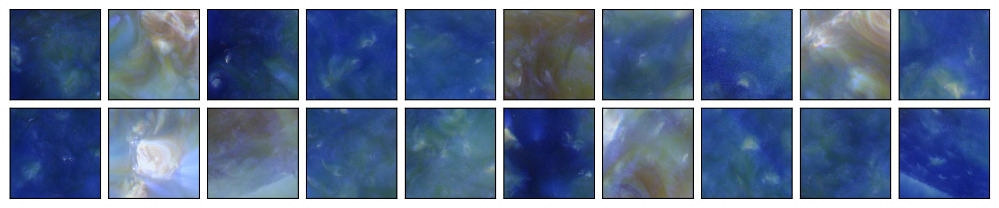

In [22]:
# Loop through all cluster labels
n_clusters_2_plot = 20

# Create a random draw of integers between a range
clusters_2_plot = np.random.choice(clusterer.labels_[clusterer.labels_ >= 0],
                                   size=n_clusters_2_plot,
                                   replace=False)

for cluster in clusters_2_plot:
  cluster_plot(cluster_rows=2,
               cluster_col=10,
               images_list=returned_images[clusterer.labels_==cluster],
               dpi=300)

In [23]:
fit = UMAP()
%time u = fit.fit_transform(normalized_embeddings)

CPU times: user 2.99 s, sys: 6.35 s, total: 9.34 s
Wall time: 413 ms


Text(0.5, 1.0, 'UMAP embedding of six dimensions')

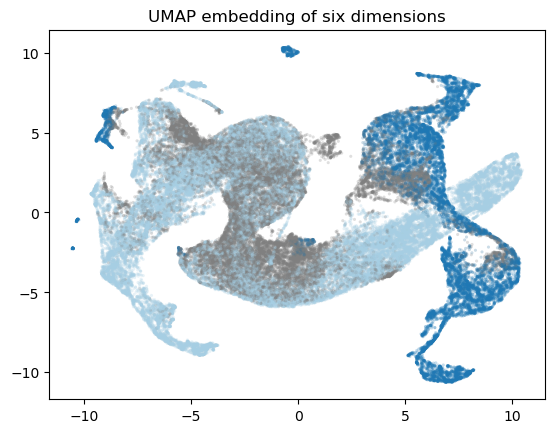

In [24]:
plt.scatter(u[:,0], u[:,1], s=5, linewidth=0, c=cluster_member_colors, alpha=0.25)
plt.title('UMAP embedding of six dimensions')

Draw Map Function

[D] [20:44:01.068733] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:108 n_neighbors=15
[D] [20:44:01.069983] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:130 Calling knn graph run
[D] [20:44:01.303530] /opt/conda/conda-bld/work/cpp/src/umap/runner.cuh:136 Done. Calling fuzzy simplicial set
[D] [20:44:01.304472] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:317 Smooth kNN Distances
[D] [20:44:01.304537] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:319 sigmas = [ 0.00554794, 0.000713162, 0.00133508, 0.00965416, 0.0124743, 0.00563228, 0.0327179, 0.00290734, 0.0194747, 0.0309834, 0.00446227, 0.0162144, 0.00623697, 0.0036267, 0.0184963, 0.0021055, 0.00863695, 0.0231094, 0.012471, 0.00760248, 0.00143969, 0.00345725, 5.51315e-05, 0.0066098, 0.000632659 ]

[D] [20:44:01.304567] /opt/conda/conda-bld/work/cpp/src/umap/fuzzy_simpl_set/naive.cuh:321 rhos = [ 0.00290529, 0.00494373, 0.0041331, 0.0169036, 0.0162698, 0.00876849, 0.0818244, 0.00313527, 0

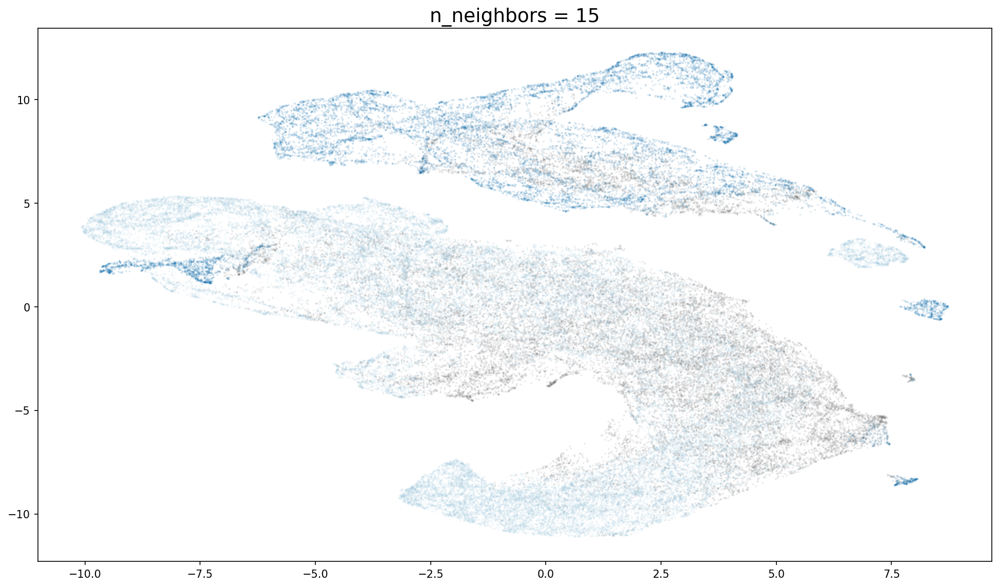

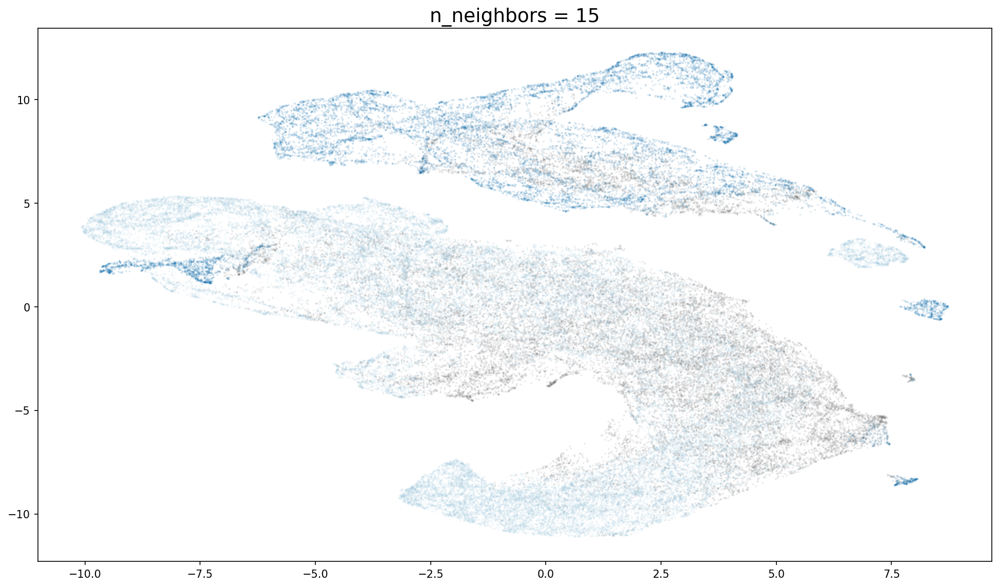

In [25]:
draw_umap(data=normalized_embeddings, colors=cluster_member_colors, n_neighbors=15, title='n_neighbors = {}'.format(15))

In [26]:
# for n in (2, 5, 10, 20, 50, 100, 200):
#     draw_umap(n_neighbors=n, title='n_neighbors = {}'.format(n))